In [1]:
import sys
import os
sys.path.append(os.path.abspath('../'))

import cv2
import matplotlib.pyplot as plt
from rectification.augmentation import horizontal_flip, gaussian_blur, resize, rotate, brightness_adjust, crop
import random

In [2]:
def select_images(folder_path, num_images=10):
    all_files = os.listdir(folder_path)
    
    image_files = [file for file in all_files if file.endswith(('.jpg', '.jpeg', '.png', '.gif', '.bmp'))]
    
    if len(image_files) < num_images:
        raise ValueError(f"Not enough images in the folder. Found {len(image_files)}, but need {num_images}.")
    
    selected_images = random.sample(image_files, num_images)
    final_images = []
    
    for img_file in selected_images:
        img_file = os.path.join(folder_path, img_file)
        final_images.append(img_file)

    return final_images

image_files = select_images('../datasets/logistics')

images = [cv2.imread(img_file) for img_file in image_files]

In [3]:
def display_images(images, titles, cols=5, img_size=(6, 6)):
    rows = len(images) // cols if len(images) % cols == 0 else (len(images) // cols) + 1
    fig, ax = plt.subplots(rows, cols, figsize=(cols * img_size[0], rows * img_size[1]))
    ax = ax.flatten()
    for i, img in enumerate(images):
        ax[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax[i].set_title(titles[i])
        ax[i].set_title(titles[i])
        ax[i].axis('off')
    plt.tight_layout()
    plt.show()

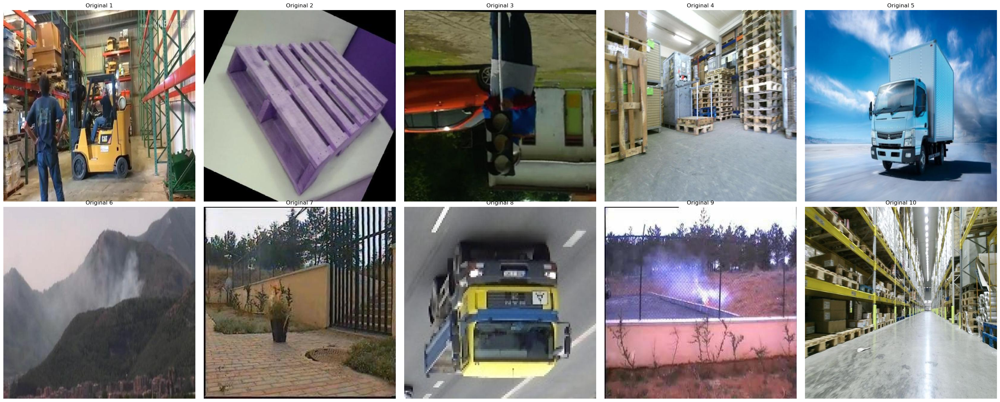

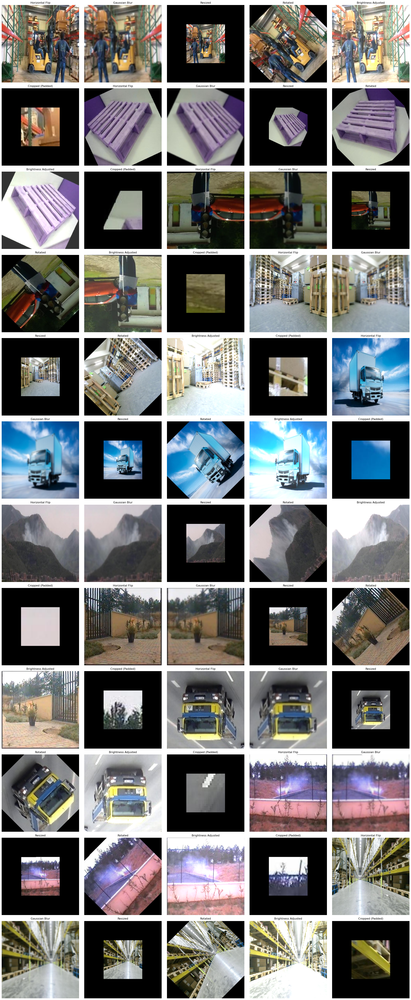

In [4]:
augmented_images = []
titles = []

display_images(images, [f'Original {i+1}' for i in range(len(images))])

for img in images:
    augmented_images.append(horizontal_flip(img))
    titles.append('Horizontal Flip')
    
    augmented_images.append(gaussian_blur(img, kernel_size=(21, 21)))
    titles.append('Gaussian Blur')

    original_height, original_width = img.shape[:2]
    resized_image = resize(img, (original_width // 2, original_height // 2))  
    padded_resized_image = cv2.copyMakeBorder(resized_image, 
                                              (original_height - resized_image.shape[0]) // 2,  
                                              (original_height - resized_image.shape[0]) // 2,  
                                              (original_width - resized_image.shape[1]) // 2,   
                                              (original_width - resized_image.shape[1]) // 2,
                                              cv2.BORDER_CONSTANT, value=[0, 0, 0])  
    augmented_images.append(padded_resized_image)
    titles.append('Resized')
    
    augmented_images.append(rotate(img, 45))
    titles.append('Rotated')

    augmented_images.append(brightness_adjust(img, alpha=1.2, beta=50))
    titles.append('Brightness Adjusted')

    cropped_image = crop(img, 50, 50, 100, 100)
    padded_crop = cv2.copyMakeBorder(cropped_image, 50, 50, 50, 50, cv2.BORDER_CONSTANT, value=[0, 0, 0])
    augmented_images.append(padded_crop)
    titles.append('Cropped (Padded)')

display_images(augmented_images, titles, img_size=(5, 5))

### 1. Horizontal Flip

**Purpose**: Flips the image along the vertical axis, creating a mirror image.

**Why it’s useful**:
- Helps the model learn symmetry and recognize objects regardless of orientation.
- Increases dataset diversity without distorting the content.
- Reduces overfitting to specific object orientations.

**Potential issues**: Not suitable for images with directional content like text or logos.

---

### 2. Gaussian Blur

**Purpose**: Applies a smoothing effect to the image, reducing sharpness and details.

**Why it’s useful**:
- Simulates out-of-focus or low-quality images, making the model more robust to noise.
- Encourages the model to focus on general shapes rather than fine details.
- Helps with generalization when real-world images contain blur from motion or camera issues.

**Potential issues**: Excessive blurring may obscure important features.

---

### 3. Resizing

**Purpose**: Changes the dimensions of the image, either reducing or enlarging it.

**Why it’s useful**:
- Standardizes input sizes for neural networks, allowing for efficient batch processing.
- Simulates images of varying resolutions to improve the model's ability to handle inputs from different devices.
- Reduces computational cost by resizing larger images, speeding up training and inference.

**Potential issues**: If resizing distorts the aspect ratio, it may lead to object deformation, confusing the model.

---

### 4. Rotation

**Purpose**: Rotates the image by a specified angle.

**Why it’s useful**:
- Helps the model recognize objects from different angles.
- Simulates real-world variations in object orientation, improving model robustness.
- Encourages the model to focus on key object features that remain invariant under transformation.

**Potential issues**: Extreme rotations may create unrealistic views or confuse models when orientation is critical (e.g., for text).

---

### 5. Brightness Adjustment

**Purpose**: Alters the brightness of the image, making it lighter or darker.

**Why it’s useful**:
- Simulates varying lighting conditions, improving the model’s performance in different environments.
- Reduces overfitting to specific lighting conditions present in the training data.
- Encourages generalization to both well-lit and dimly-lit scenarios.

**Potential issues**: Excessive brightness or darkness may obscure important features or make objects hard to distinguish.

---

### 6. Cropping

**Purpose**: Removes part of the image, focusing on a specific region.

**Why it’s useful**:
- Helps the model learn to focus on important regions of the image while ignoring the irrelevant background.
- Simulates occlusions by training the model to recognize partially visible objects.
- Encourages robustness by training on incomplete views of objects.

**Potential issues**: Over-cropping can remove important context from the image, affecting the model’s ability to classify objects correctly.
